# Networks and Algorithms Project
Leylga Gasimova

Laman Mammadova

Elchin Gurbanli

# Importing libraries

In [1]:
import random 
import math
import pandas as pd
import networkx as nx
import matplotlib as mpl
import matplotlib.pyplot as plt

# Reading CSV files

In [2]:
airports_df = pd.read_csv('./data/airports.csv')
routes_df = pd.read_csv('./data/routes.csv')

In [3]:
print(airports_df.columns)
print(routes_df.columns)

Index(['Airport ID', 'Name', 'City', 'Country', 'IATA', 'ICAO', 'Latitude',
       'Longitude', 'Altitude', 'Timezone', 'DST', 'Tz database time zone',
       'Type', 'Source'],
      dtype='object')
Index(['Airline', 'Airline ID', 'Source airport', 'Source airport ID',
       'Destination airport', 'Destination airport ID', 'Codeshare', 'Stops',
       'Equipment'],
      dtype='object')


In [4]:
data_type = []
for i in airports_df.columns:
    data_type.append(airports_df[i].dtype)
pd.DataFrame(list(zip(airports_df.columns, data_type)), columns=['Variables','Data types'])

,Variables,Data types
0,Airport ID,int64
1,Name,object
2,City,object
3,Country,object
4,IATA,object
5,ICAO,object
6,Latitude,float64
7,Longitude,float64
8,Altitude,int64
9,Timezone,object


In [5]:
routes_df.eq(r'\N').any(1).sum()

898

# Cleaning routes file

In [6]:
for index, row in routes_df.iterrows():
  if( row['Source airport ID'] == "\\N" ):
    cur_row = airports_df.loc[airports_df['IATA'] == row['Source airport']]
    if(cur_row.size==0):
      routes_df = routes_df.drop(index)
      continue
    else:
      routes_df.at[index, 'Source airport ID'] = int(cur_row['Airport ID'])  
  if( row['Destination airport ID'] == "\\N" ):
    cur_row = airports_df.loc[airports_df['IATA'] == row['Destination airport']]
    if(cur_row.size==0):
      routes_df = routes_df.drop(index)
    else:
      routes_df.at[index, 'Destination airport ID'] = int(cur_row['Airport ID'])
print(routes_df)      

      Airline Airline ID Source airport Source airport ID Destination airport  \
0          2B        410            AER              2965                 KZN   
1          2B        410            ASF              2966                 KZN   
2          2B        410            ASF              2966                 MRV   
3          2B        410            CEK              2968                 KZN   
4          2B        410            CEK              2968                 OVB   
...       ...        ...            ...               ...                 ...   
67658      ZL       4178            WYA              6334                 ADL   
67659      ZM      19016            DME              4029                 FRU   
67660      ZM      19016            FRU              2912                 DME   
67661      ZM      19016            FRU              2912                 OSS   
67662      ZM      19016            OSS              2913                 FRU   

      Destination airport I

In [7]:
routes_df.eq(r'\N').any(1).sum()

479

# Finding all airports in Oceania Region

In [8]:
oceania_countries = ['Australia','Papua New Guinea','New Zealand','Solomon Islands','Fiji','Vanuatu','Samoa','Kiribati','Tonga','Federated States of Micronesia','Palau','Marshall Islands','Tuvalu','Nauru']
oceania_df = airports_df.loc[airports_df['Country'] == oceania_countries[0]]
for i in range(1,len(oceania_countries)):
  oceania_df = oceania_df.append(airports_df.loc[airports_df['Country'] == oceania_countries[i]])
print(oceania_df)

      Airport ID                            Name            City  \
3125        3317    Brisbane Archerfield Airport        Brisbane   
3126        3318      Northern Peninsula Airport        Amberley   
3127        3319           Alice Springs Airport   Alice Springs   
3128        3320  Brisbane International Airport        Brisbane   
3129        3321              Gold Coast Airport     Coolangatta   
...          ...                             ...             ...   
4504        5833             Mili Island Airport     Mili Island   
4635        5990                Eniwetok Airport  Eniwetok Atoll   
4739        6100              Ujae Atoll Airport      Ujae Atoll   
3856        4077  Funafuti International Airport        Funafuti   
3855        4076     Nauru International Airport           Nauru   

               Country IATA  ICAO   Latitude   Longitude  Altitude Timezone  \
3125         Australia  ACF  YBAF -27.570299  153.007996        63       10   
3126         Australia  A

# Finding number of flights to and from Oceania

In [9]:
to_oceania_df = routes_df.loc[routes_df['Destination airport ID'] == oceania_df['Airport ID'][0]]
from_oceania_df = routes_df.loc[routes_df['Source airport ID'] == oceania_df['Airport ID'][0]]
num_flights_to = []
num_flights_from = []
for index, row in oceania_df.iterrows():
  df_to = routes_df.loc[routes_df['Destination airport ID'] == str(row['Airport ID'])]
  df_from = routes_df.loc[routes_df['Source airport ID'] == str(row['Airport ID'])]
  to_oceania_df = to_oceania_df.append(df_to)
  from_oceania_df = from_oceania_df.append(df_from)
  num_flights_to.append(df_to.size)
  num_flights_from.append(df_from.size)

In [10]:
se_to = pd.Series(num_flights_to)
se_from = pd.Series(num_flights_from)
oceania_df["# Flights To"] = se_to.values
oceania_df["# Flights From"] = se_from.values
sum_column = oceania_df["# Flights To"] + oceania_df["# Flights From"]
oceania_df["Popularity"] = sum_column

# Sorting airports based on Importance

In [11]:
oceania_df.sort_values(by=['Popularity'], ascending=False)

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source,# Flights To,# Flights From,Popularity
3167,3361,Sydney Kingsford Smith International Airport,Sydney,Australia,SYD,YSSY,-33.946098,151.177002,21,10,O,Australia/Sydney,airport,OurAirports,1818,1872,3690
3128,3320,Brisbane International Airport,Brisbane,Australia,BNE,YBBN,-27.384199,153.117004,13,10,N,Australia/Brisbane,airport,OurAirports,1287,1359,2646
3146,3339,Melbourne International Airport,Melbourne,Australia,MEL,YMML,-37.673302,144.843002,434,10,O,Australia/Hobart,airport,OurAirports,1188,1233,2421
1936,2006,Auckland International Airport,Auckland,New Zealand,AKL,NZAA,-37.008099,174.792007,23,12,Z,Pacific/Auckland,airport,OurAirports,1053,864,1917
3157,3351,Perth International Airport,Perth,Australia,PER,YPPH,-31.940300,115.967003,67,8,N,Australia/Perth,airport,OurAirports,810,828,1638
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6772,10378,Coondewanna Airport,Coondewanna,Australia,CJF,YCWA,-22.966700,118.813004,2300,8,N,\N,airport,OurAirports,0,0,0
6770,10370,Kadina Airport,Kadina,Australia,\N,YKDI,-33.976700,137.660004,42,9.5,O,\N,airport,OurAirports,0,0,0
6739,10140,Atherton Airport,Atherton,Australia,\N,YATN,-17.261700,145.514999,2450,10,O,\N,airport,OurAirports,0,0,0
6723,10116,Bunbury Airport,Bunbury,Australia,BUY,YBUN,-33.378300,115.677002,53,8,U,\N,airport,OurAirports,0,0,0


#5 most popular airports in Oceania:

\#1 Sydney Kingsford Smith International Airport, Sydney, Australia

Flights To = 1818	

Flights From = 1872

\#2 Brisbane International Airport,	Brisbane	,Australia

Flights To = 1296 

Flights From = 1368

\#3 Melbourne International Airport,	Melbourne,	Australia

Flights To = 1188

Flights From = 1233

\#4 Auckland International Airport	, Auckland, New Zealand

Flights To = 1053

Flights From = 864

\#5 Perth International Airport,	Perth,	Australia

Flights To = 810

Flights From = 828


# Counting number of all flights and only inner flights in Oceania 

In [12]:
print(from_oceania_df.size)
print(to_oceania_df.size)

15759
15822


In [13]:
oceania_all_flights = to_oceania_df.append(from_oceania_df)
oceania_all_flights = oceania_all_flights.drop_duplicates()
print(oceania_all_flights.size)

18549


In [14]:
oceania_inner_flights = pd.merge(from_oceania_df , to_oceania_df, how ='inner')
oceania_inner_flights = oceania_inner_flights.drop_duplicates()
print(oceania_inner_flights.size)

13032


# Calculating distance between airports

## For Oceania Region

In [15]:
def distance(latitude1, latitude2, longitude1, longitude2):
  latitude1 = math.radians(latitude1)
  longitude1 = math.radians(longitude1)
  latitutde2 = math.radians(latitude2)
  longitude2 = math.radians(longitude2)
  lon_diff = longitude2 - longitude1
  lat_diff = latitude2 - latitude1
  a = math.sin(lat_diff / 2)**2 + math.cos(latitude1) * math.cos(latitude2) * math.sin(lon_diff / 2)**2
  c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
  distance = 6373.0 * c
  return distance

In [16]:
def calculate_distance(airport_id1, airport_id2):
  airport1 = airports_df.loc[airports_df['Airport ID'] == airport_id1]
  airport2 = airports_df.loc[airports_df['Airport ID'] == airport_id2]
  if(airport1.size == 0 or airport2.size==0):
    return 0
  latitude1 = airport1['Latitude']
  latitude2 = airport2['Latitude']
  longitude1 = airport1['Longitude']
  longitude2 = airport2['Longitude']
  dist = distance(latitude1,latitude2, longitude1, longitude2)
  return dist

In [17]:
distances = []
for index, row in oceania_all_flights.iterrows():
  id1 = int(row['Source airport ID'])
  id2 = int(row['Destination airport ID'])
  d = calculate_distance(id1,id2)
  distances.append(d)
se_distances = pd.Series(distances)
oceania_all_flights["Distance"] = se_distances.values
print(oceania_all_flights)

      Airline Airline ID Source airport Source airport ID Destination airport  \
46603      Q6        753            CNS              3322                 ABM   
6876       AA         24            SYD              3361                 ASP   
23116      EK       2183            DRW              3999                 ASP   
23313      EK       2183            PER              3351                 ASP   
46736      QF       4089            ADL              3341                 ASP   
...       ...        ...            ...               ...                 ...   
57557      UA       5209            ROR              2256                 MNL   
57558      UA       5209            ROR              2256                 YAP   
57074      UA       5209            MAJ              2249                 HNL   
56932      UA       5209            KWA              2251                 KSA   
56934      UA       5209            KWA              2251                 PNI   

      Destination airport I

In [18]:
oceania_all_flights.sort_values(by=['Distance'], ascending=False)

,Airline,Airline ID,Source airport,Source airport ID,Destination airport,Destination airport ID,Codeshare,Stops,Equipment,Distance
49558,SH,10675,FLS,6267,LST,3337,NaN,0,SWM,19948.320271
46452,PX,328,MAS,5430,POM,5,NaN,0,100 737,19908.281457
49557,SH,10675,BWT,6338,LST,3337,NaN,0,SWM,19878.072938
67626,ZL,4178,NTL,4320,BNK,4291,NaN,0,SF3,19839.745408
43850,NZ,345,AKL,2006,BHE,2037,Y,0,DH3 BEH,19803.860514
...,...,...,...,...,...,...,...,...,...,...
17342,CG,1308,LSA,5980,GUR,5422,NaN,0,DH8,0.000000
33045,IE,4797,HIR,4074,BNY,6919,NaN,0,DHT,0.000000
46445,PX,328,LNV,5979,RAB,5435,NaN,0,DH3,0.000000
33081,IE,4797,RNL,5414,BNY,6919,NaN,0,DHT,0.000000


## Analyzing all routes

In [19]:
all_distances = []
for index, row in routes_df.iterrows():
  id1 = int(row['Source airport ID'])
  id2 = int(row['Destination airport ID'])
  d = calculate_distance(id1,id2)
  all_distances.append(d)
se_all_distances = pd.Series(all_distances)
routes_df["Distance"] = se_all_distances.values

In [20]:
routes_df.sort_values(by=['Distance'], ascending=False)

,Airline,Airline ID,Source airport,Source airport ID,Destination airport,Destination airport ID,Codeshare,Stops,Equipment,Distance
60155,US,5265,PHX,3462,FLG,4261,Y,0,CRJ,19985.743030
6537,AA,24,PHX,3462,FLG,4261,Y,0,CRJ,19985.743030
49558,SH,10675,FLS,6267,LST,3337,NaN,0,SWM,19948.320271
13217,AZ,596,CPH,609,FCO,1555,NaN,0,32S 319,19945.607988
22380,DY,3737,CPH,609,FCO,1555,NaN,0,73H,19945.607988
...,...,...,...,...,...,...,...,...,...,...
33045,IE,4797,HIR,4074,BNY,6919,NaN,0,DHT,0.000000
1736,4Y,1173,KKI,9742,AKI,7217,NaN,0,CNA,0.000000
1738,4Y,1173,KUK,7094,NUP,7212,NaN,0,CNA,0.000000
1742,4Y,1173,KWT,7095,KKI,9742,NaN,0,CNA,0.000000


# Creating Graphs and adding weights

In [21]:
def adding_weights(G):
  edges = list(G.edges)
  weight = 0
  for i in edges:
    airport1 = airports_df.loc[airports_df['IATA'] == i[0]]
    airport2 = airports_df.loc[airports_df['IATA'] == i[1]]
    if(airport1.size == 0 or airport2.size==0):
      return 0
    weight = calculate_distance(int(airport1['Airport ID']), int(airport2['Airport ID']))
    G[i[0]][i[1]]['weight'] = weight

In [22]:
G_inner = nx.from_pandas_edgelist(oceania_inner_flights, source='Source airport', target='Destination airport', edge_attr=True, create_using=nx.DiGraph())
G_to_oceania = nx.from_pandas_edgelist(to_oceania_df, source='Source airport', target='Destination airport', edge_attr=True, create_using=nx.DiGraph())
G_from_oceania = nx.from_pandas_edgelist(from_oceania_df, source='Source airport', target='Destination airport', edge_attr=True, create_using=nx.DiGraph())
G_all_flights = nx.from_pandas_edgelist(oceania_all_flights, source='Source airport', target='Destination airport', edge_attr=True, create_using=nx.DiGraph())

adding_weights(G_inner)
adding_weights(G_to_oceania)
adding_weights(G_from_oceania)
adding_weights(G_all_flights)

0

# Visualizing graphs

In [23]:
def show_graph(G, node_size):
  options = {
    "node_color": "black",
    "node_size": node_size,
    "linewidths": 0.1,
    "width": 1,
  }
  fig = plt.figure(1, figsize=(50, 40))
  pos = nx.random_layout(G)
  nx.draw(G, pos, **options)
  plt.show()


## Inner Flights graph

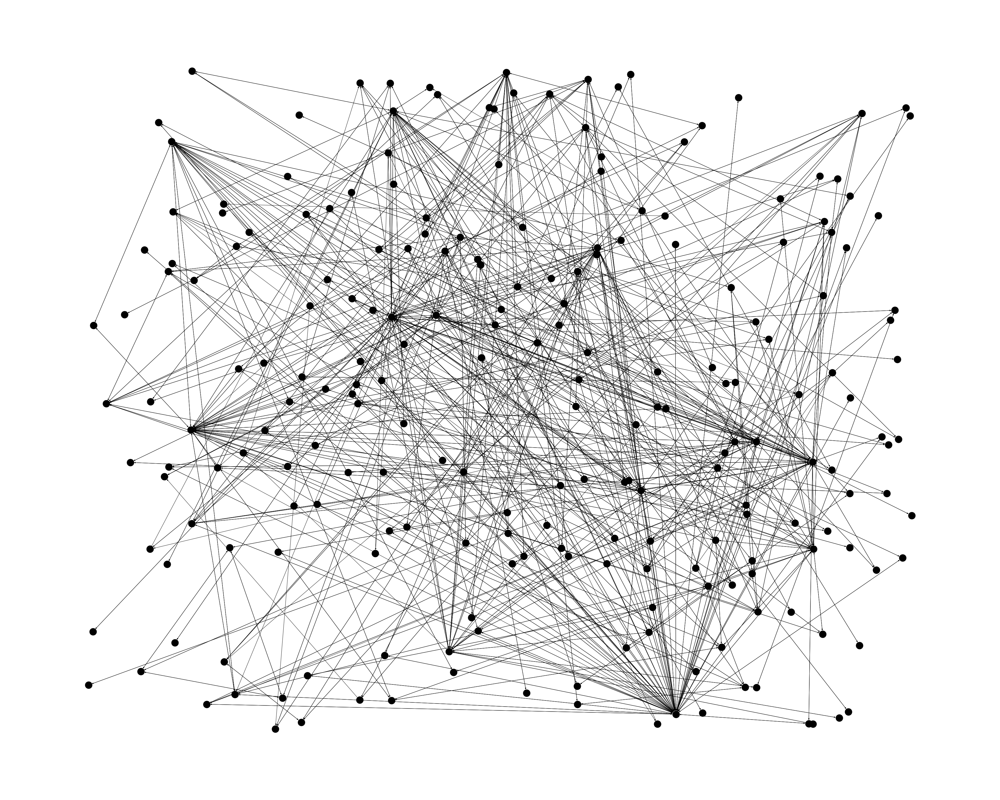

In [24]:
show_graph(G_inner,700)

## Flights to Oceania graph

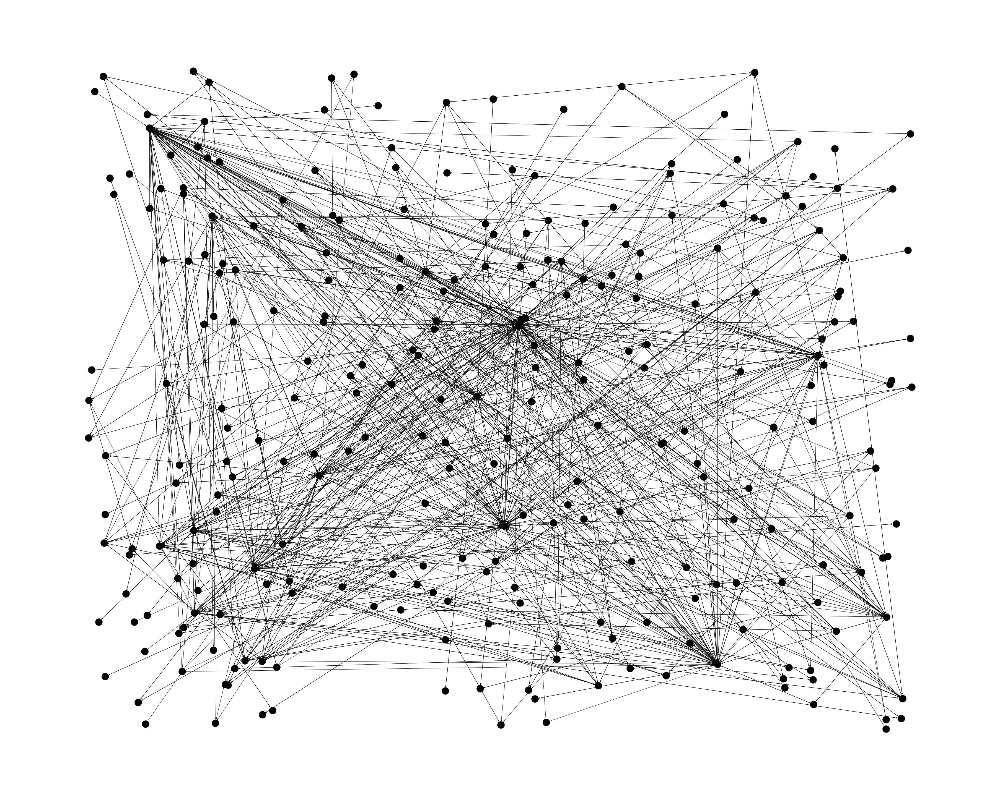

In [25]:
show_graph(G_to_oceania,700)

## Flights from Oceania 

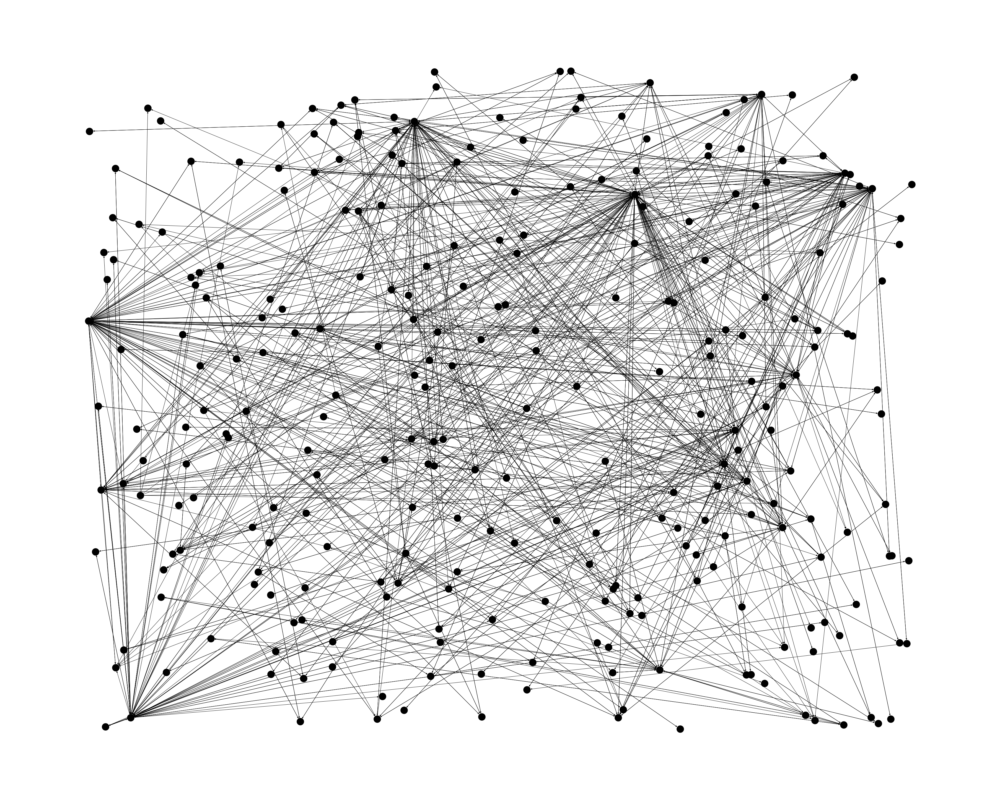

In [26]:
show_graph(G_from_oceania,700)

## All flights in and from Oceania, international and inner

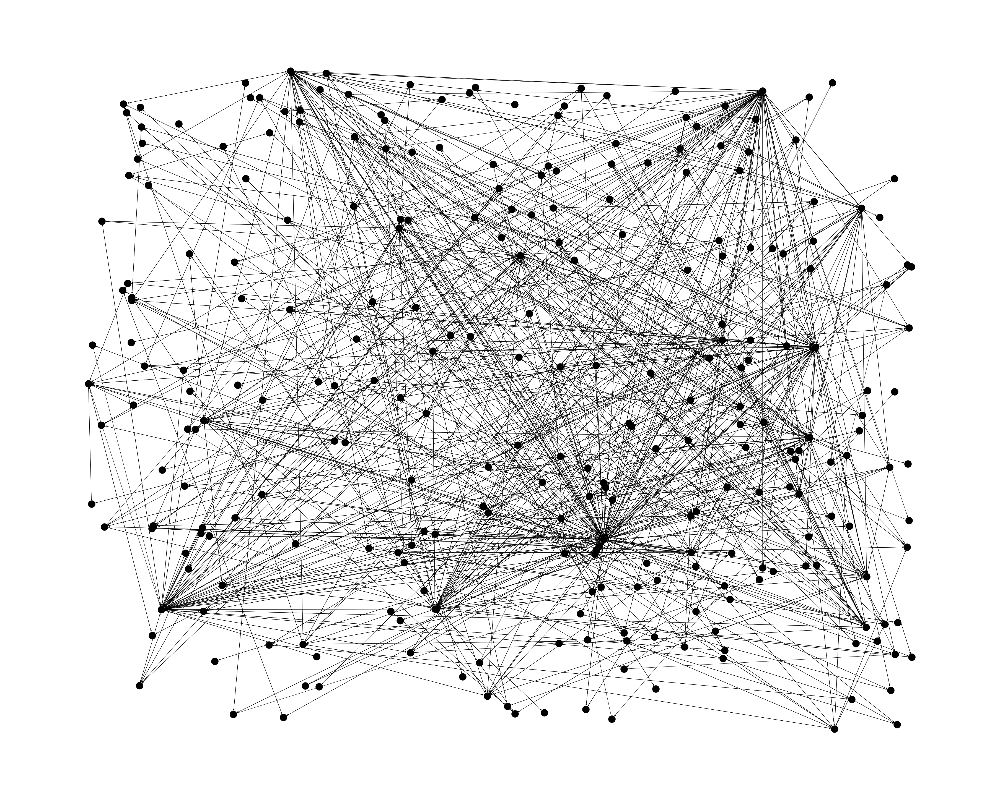

In [27]:
show_graph(G_all_flights,700)

## All airports in Oceania and all flights

In [28]:
nodes = G_all_flights.nodes
G_all_airports = G_all_flights
for index, row in oceania_df.iterrows():
  if(row['IATA'] != "\\N"):
    if(row['IATA'] not in list(nodes)):
      G_all_airports.add_node(row['IATA'])

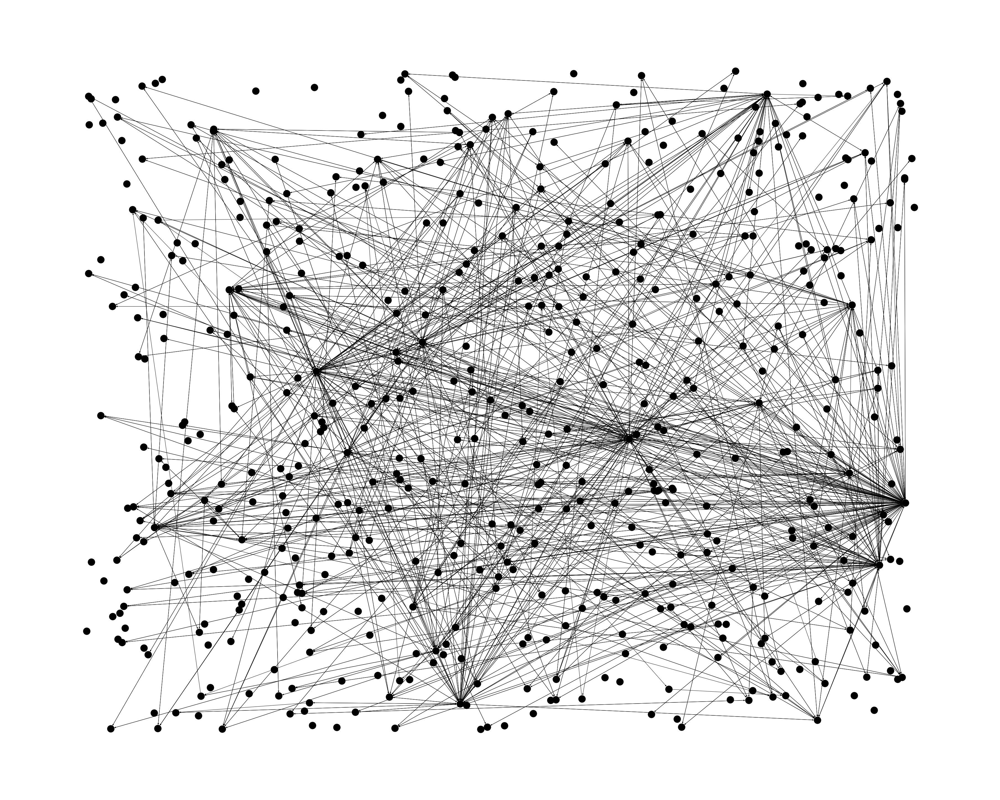

In [29]:
options = {
    "node_color": "black",
    "node_size": 700,
    "linewidths": 0,
    "width": 1,
  }
fig = plt.figure(1, figsize=(50, 40))
pos = nx.random_layout(G_all_airports) 
nx.draw(G_all_airports, pos, **options)
plt.show()




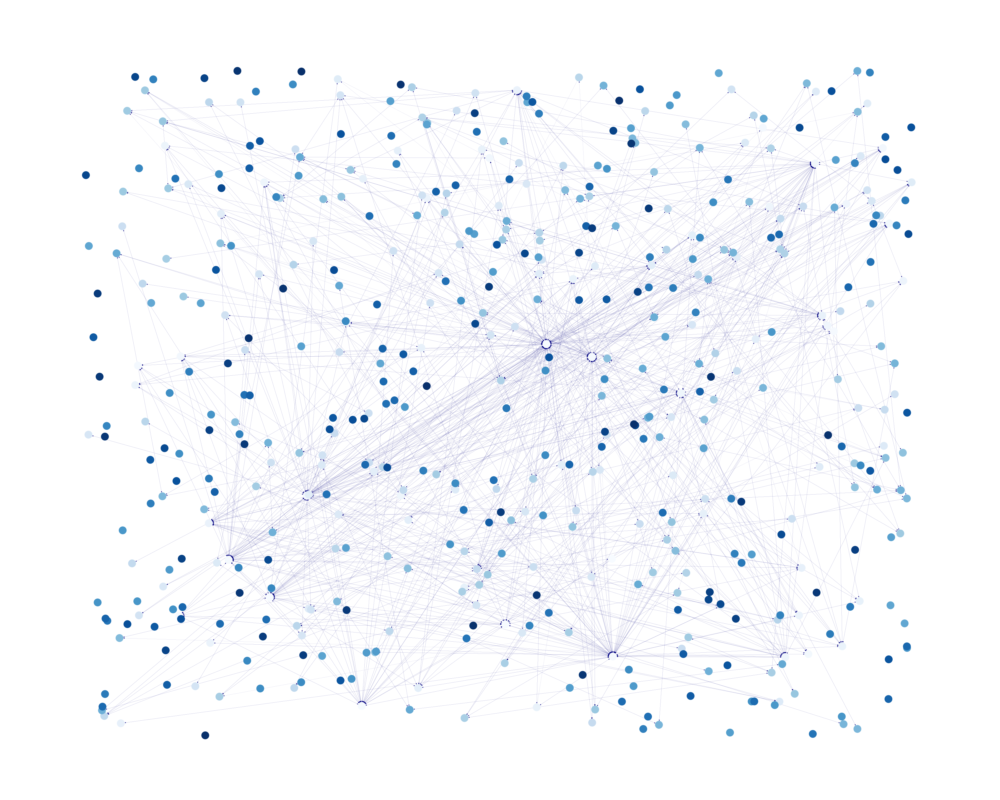

In [30]:
options = {
    "node_color": range(len(G_all_airports.nodes)),
    "edge_color": "#000080",
    "node_size": 800,
    "linewidths": 0,
    "width": 0.1,
  }
fig = plt.figure(1, figsize=(50, 40))
pos = nx.random_layout(G_all_airports) 
nx.draw(G_all_airports, pos, **options, cmap = plt.cm.Blues )
plt.show()


# Shortest Paths

In [31]:
nodes = G_all_airports.nodes
random.seed(13)
for i in range(0,10):
  i1 = random.randrange(len(G_all_flights.nodes))
  i2 = random.randrange(len(G_all_flights.nodes))
  try:
    sp_dijkstra = nx.dijkstra_path(G_all_flights,list(nodes)[i1], list(nodes)[i2], weight='weight')
    sp_bellman_ford = nx.bellman_ford_path(G_all_flights,list(nodes)[i1], list(nodes)[i2], weight='weight')
    print("Shortest path using Dijkstra alogorithm, from node "+list(nodes)[i1]+" to node " + list(nodes)[i2])
    print(sp_dijkstra)
    print("Shortest path using Bellman Ford algorithm, from node "+list(nodes)[i1]+" to node " + list(nodes)[i2])
    print(sp_bellman_ford)
    print('\n')
  except nx.NetworkXNoPath:
    print("No path from node "+list(nodes)[i1]+" to node " + list(nodes)[i2] )
    print('\n')



No path from node LOD to node MHU


Shortest path using Dijkstra alogorithm, from node LSA to node SVU
['LSA', 'GUR', 'POM', 'MNL', 'ROR', 'ICN', 'NAN', 'SVU']
Shortest path using Bellman Ford algorithm, from node LSA to node SVU
['LSA', 'GUR', 'POM', 'MNL', 'ROR', 'ICN', 'NAN', 'SVU']


Shortest path using Dijkstra alogorithm, from node MNG to node KGE
['MNG', 'DRW', 'MEL', 'ZQN', 'CHC', 'OOL', 'NRT', 'ROR', 'ICN', 'NAN', 'HIR', 'KGE']
Shortest path using Bellman Ford algorithm, from node MNG to node KGE
['MNG', 'DRW', 'MEL', 'ZQN', 'CHC', 'OOL', 'NRT', 'ROR', 'ICN', 'NAN', 'HIR', 'KGE']


Shortest path using Dijkstra alogorithm, from node TFI to node NKG
['TFI', 'PNP', 'POM', 'DPS', 'SYD', 'NKG']
Shortest path using Bellman Ford algorithm, from node TFI to node NKG
['TFI', 'PNP', 'POM', 'DPS', 'SYD', 'NKG']


Shortest path using Dijkstra alogorithm, from node ULP to node FRE
['ULP', 'WNR', 'BVI', 'BEU', 'BQL', 'ISA', 'OOL', 'NRT', 'ROR', 'ICN', 'NAN', 'HIR', 'FRE']
Shortest path usin

# Degree of graph and its nodes

In [32]:
nodes = list(G_all_airports.nodes)
degrees = []
for index, row in oceania_df.iterrows():
  if(row['IATA'] in nodes):
      degrees.append(G_all_airports.degree[row['IATA']])
  else:
      degrees.append(0)
se_degrees = pd.Series(degrees)
oceania_df["Degree of Node"] = se_degrees.values      

In [33]:
oceania_df.sort_values(by=['Degree of Node'], ascending=False)

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source,# Flights To,# Flights From,Popularity,Degree of Node
3167,3361,Sydney Kingsford Smith International Airport,Sydney,Australia,SYD,YSSY,-33.946098,151.177002,21,10,O,Australia/Sydney,airport,OurAirports,1818,1872,3690,168
3128,3320,Brisbane International Airport,Brisbane,Australia,BNE,YBBN,-27.384199,153.117004,13,10,N,Australia/Brisbane,airport,OurAirports,1287,1359,2646,114
3146,3339,Melbourne International Airport,Melbourne,Australia,MEL,YMML,-37.673302,144.843002,434,10,O,Australia/Hobart,airport,OurAirports,1188,1233,2421,109
1936,2006,Auckland International Airport,Auckland,New Zealand,AKL,NZAA,-37.008099,174.792007,23,12,Z,Pacific/Auckland,airport,OurAirports,1053,864,1917,95
3157,3351,Perth International Airport,Perth,Australia,PER,YPPH,-31.940300,115.967003,67,8,N,Australia/Perth,airport,OurAirports,810,828,1638,76
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6772,10378,Coondewanna Airport,Coondewanna,Australia,CJF,YCWA,-22.966700,118.813004,2300,8,N,\N,airport,OurAirports,0,0,0,0
6770,10370,Kadina Airport,Kadina,Australia,\N,YKDI,-33.976700,137.660004,42,9.5,O,\N,airport,OurAirports,0,0,0,0
6739,10140,Atherton Airport,Atherton,Australia,\N,YATN,-17.261700,145.514999,2450,10,O,\N,airport,OurAirports,0,0,0,0
6723,10116,Bunbury Airport,Bunbury,Australia,BUY,YBUN,-33.378300,115.677002,53,8,U,\N,airport,OurAirports,0,0,0,0


In [34]:
avg_degree_connectivity_without_isolated_vertices = nx.average_degree_connectivity(G_all_flights, weight = 'weight')
avg_degree_connectivity_with_isolated_vertices = nx.average_degree_connectivity(G_all_airports, weight = 'weight')

print("Average degree of connectivity without isolated vertices: " + str(avg_degree_connectivity_without_isolated_vertices))
print("Average degree of connectivity with isolated vertices:    " + str(avg_degree_connectivity_with_isolated_vertices))


Average degree of connectivity without isolated vertices: {59: 19.5797916120742, 2: 4.092702918961073, 168: 12.82265797041448, 16: 16.35214820442424, 40: 26.932965014282015, 76: 19.51584796297975, 52: 17.41836326898147, 6: 14.51320961748665, 114: 17.5338114210897, 109: 19.379184618063558, 95: 20.461031790139902, 12: 32.96305085891117, 10: 10.208922536241257, 20: 41.781312845349234, 18: 38.23413162861916, 69: 22.255414271957143, 47: 0.012611486666369033, 15: 0.011823278871611565, 38: 0.00965663201566029, 8: 0.013568086551302365, 4: 0.014366086523460515, 41: 0.01784383411587446, 5: 0.017021549070505456, 42: 0.008655093402662916, 11: 0.017823168314471498, 26: 0.005739386974482312, 14: 0.015710290823200617, 1: 48.5, 3: 0.014518912900546254, 23: 0.03700455285280823, 17: 0.03335339902067981, 7: 0.017746369356703245, 9: 6.222222222222222, 0: 0}
Average degree of connectivity with isolated vertices:    {59: 19.5797916120742, 2: 4.092702918961073, 168: 12.82265797041448, 16: 16.35214820442424, 

In [35]:
def plot_avg_degree_connectivity(average_degree_connectivity, title):
  l = average_degree_connectivity.items()
  l = sorted(l)
  x, y = zip(*l)
  plt.figure(figsize=(14,7)) # Make it 14x7 inch
  plt.style.use('seaborn-whitegrid') # nice and clean grid
  plt.title(title)
  plt.plot(x,y,color = 'green')
  plt.show()

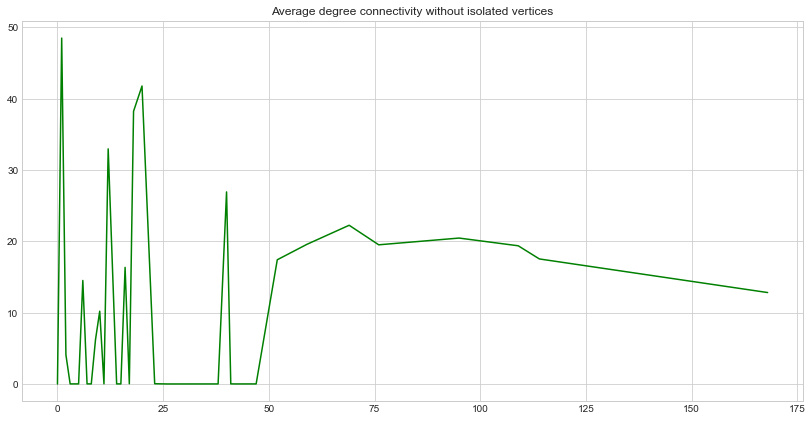

In [36]:
plot_avg_degree_connectivity(avg_degree_connectivity_without_isolated_vertices, "Average degree connectivity without isolated vertices")

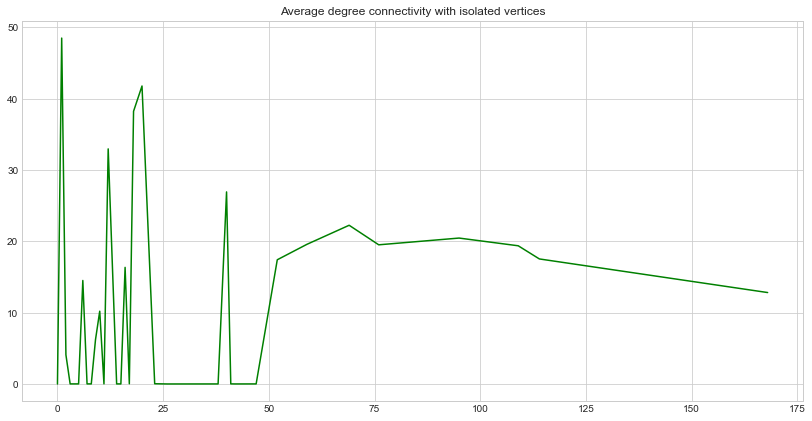

In [37]:
plot_avg_degree_connectivity(avg_degree_connectivity_with_isolated_vertices, "Average degree connectivity with isolated vertices")

# Closeness Centrality

In [38]:
def plot_histogram(data, title):
  plt.figure(figsize=(14,7)) 
  plt.style.use('seaborn-whitegrid')
  plt.hist(data, bins=10 ,facecolor = '#dbe7cb', edgecolor='#002626', linewidth=0.5)
  plt.title(title) 
  plt.show()


In [39]:
closeness_centrality = []
for index, row in oceania_df.iterrows():
  if(row['IATA'] in nodes):
      closeness_centrality.append( nx.closeness_centrality(G_all_airports,row['IATA']) )
  else:
      closeness_centrality.append(0)
se_centrality = pd.Series(closeness_centrality)
oceania_df["Closeness Centrality"] = se_centrality.values      

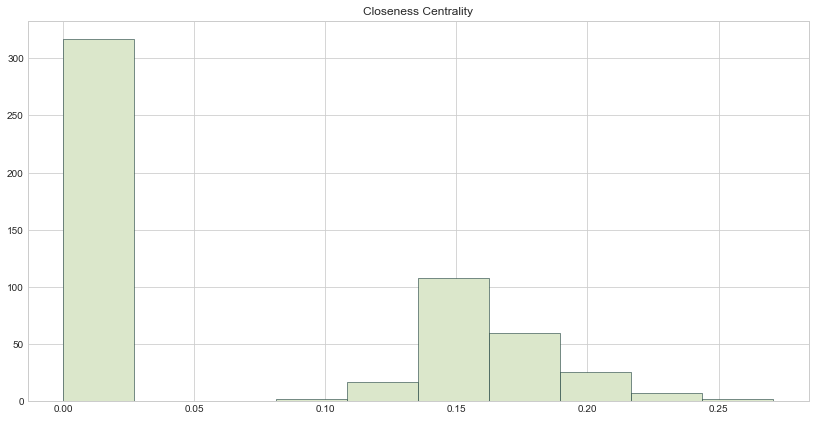

In [40]:
plot_histogram(closeness_centrality, 'Closeness Centrality')


In [41]:
oceania_df.sort_values(by=['Closeness Centrality'], ascending=False)

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source,# Flights To,# Flights From,Popularity,Degree of Node,Closeness Centrality
3128,3320,Brisbane International Airport,Brisbane,Australia,BNE,YBBN,-27.384199,153.117004,13,10,N,Australia/Brisbane,airport,OurAirports,1287,1359,2646,114,0.270855
3167,3361,Sydney Kingsford Smith International Airport,Sydney,Australia,SYD,YSSY,-33.946098,151.177002,21,10,O,Australia/Sydney,airport,OurAirports,1818,1872,3690,168,0.269838
1936,2006,Auckland International Airport,Auckland,New Zealand,AKL,NZAA,-37.008099,174.792007,23,12,Z,Pacific/Auckland,airport,OurAirports,1053,864,1917,95,0.237725
3146,3339,Melbourne International Airport,Melbourne,Australia,MEL,YMML,-37.673302,144.843002,434,10,O,Australia/Hobart,airport,OurAirports,1188,1233,2421,109,0.234623
3130,3322,Cairns International Airport,Cairns,Australia,CNS,YBCS,-16.885799,145.755005,10,10,N,Australia/Brisbane,airport,OurAirports,486,504,990,59,0.231228
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6770,10370,Kadina Airport,Kadina,Australia,\N,YKDI,-33.976700,137.660004,42,9.5,O,\N,airport,OurAirports,0,0,0,0,0.000000
6739,10140,Atherton Airport,Atherton,Australia,\N,YATN,-17.261700,145.514999,2450,10,O,\N,airport,OurAirports,0,0,0,0,0.000000
6723,10116,Bunbury Airport,Bunbury,Australia,BUY,YBUN,-33.378300,115.677002,53,8,U,\N,airport,OurAirports,0,0,0,0,0.000000
6698,9902,Warrnambool Airport,Warrnambool,Australia,WMB,YWBL,-38.295300,142.447006,242,10,O,\N,airport,OurAirports,0,0,0,0,0.000000


# Betweennes Centrality

In [42]:
betweenness_centrality = nx.betweenness_centrality(G_all_airports)
bc = []
for index, row in oceania_df.iterrows():
  if(row['IATA'] in nodes):
      bc.append( betweenness_centrality[row['IATA']])
  else:
      bc.append(0)
se_between_centrality = pd.Series(bc)
oceania_df["Betweenness Centrality"] = se_between_centrality.values      

In [43]:
oceania_df.sort_values(by=['Betweenness Centrality'], ascending=False)

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source,# Flights To,# Flights From,Popularity,Degree of Node,Closeness Centrality,Betweenness Centrality
3167,3361,Sydney Kingsford Smith International Airport,Sydney,Australia,SYD,YSSY,-33.946098,151.177002,21,10,O,Australia/Sydney,airport,OurAirports,1818,1872,3690,168,0.269838,0.085776
3128,3320,Brisbane International Airport,Brisbane,Australia,BNE,YBBN,-27.384199,153.117004,13,10,N,Australia/Brisbane,airport,OurAirports,1287,1359,2646,114,0.270855,0.081945
4,5,Port Moresby Jacksons International Airport,Port Moresby,Papua New Guinea,POM,AYPY,-9.443380,147.220001,146,10,U,Pacific/Port_Moresby,airport,OurAirports,450,468,918,69,0.220251,0.051494
1927,1997,Bauerfield International Airport,Port-vila,Vanuatu,VLI,NVVV,-17.699301,168.320007,70,11,U,Pacific/Efate,airport,OurAirports,252,252,504,40,0.216276,0.036254
1936,2006,Auckland International Airport,Auckland,New Zealand,AKL,NZAA,-37.008099,174.792007,23,12,Z,Pacific/Auckland,airport,OurAirports,1053,864,1917,95,0.237725,0.035592
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6129,8380,Mallacoota Airport,Mallacoota,Australia,XMC,YMCO,-37.598301,149.720001,31,10,U,Australia/Hobart,airport,OurAirports,0,0,0,0,0.000000,0.000000
6114,8354,Ballarat Airport,Ballarat,Australia,\N,YBLT,-37.511700,143.791000,1433,10,O,Australia/Hobart,airport,OurAirports,0,0,0,0,0.000000,0.000000
6113,8353,Forrest Airport,Forrest,Australia,FOS,YFRT,-30.838100,128.115005,511,8,O,Australia/Perth,airport,OurAirports,0,0,0,0,0.000000,0.000000
6112,8352,Rottnest Island Airport,Rottnest Island,Australia,RTS,YRTI,-32.006699,115.540001,12,8,O,Australia/Perth,airport,OurAirports,0,0,0,0,0.000000,0.000000


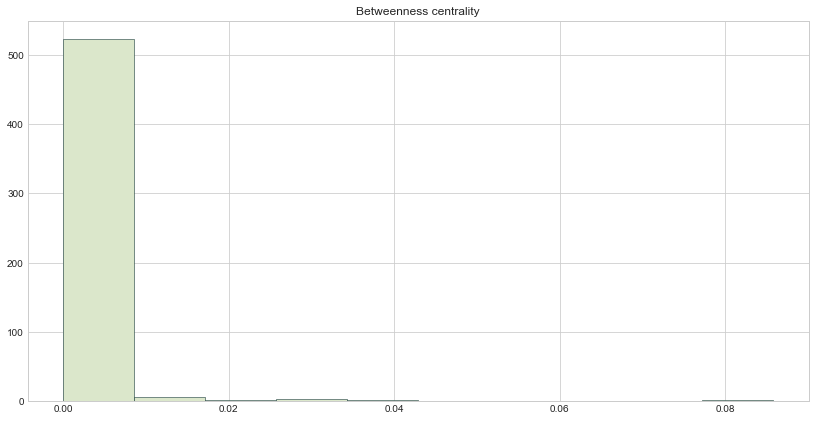

In [44]:
plot_histogram(bc,'Betweenness centrality' )


# Network analysis

## Density

In [45]:
density_with_isolated  = nx.density(G_all_airports)
density_without_isolated  = nx.density(G_all_flights)
print("Network density = "+str(density_with_isolated)+" for netwrok with isolated vertices")
print("Network density = "+str(density_without_isolated)+" for netwrok without isolated vertices")


Network density = 0.00437719317524157 for netwrok with isolated vertices
Network density = 0.00437719317524157 for netwrok without isolated vertices


## Diameter

In [46]:
G_undirected_all_flights = nx.from_pandas_edgelist(oceania_all_flights, source='Source airport', target='Destination airport', edge_attr=True)
G_undirected_inner_flights = nx.from_pandas_edgelist(oceania_inner_flights, source='Source airport', target='Destination airport', edge_attr=True)
diameter1 = nx.diameter(G_undirected_all_flights)
diameter2 = nx.diameter(G_undirected_inner_flights)

print("For undirected netwrok of all flights without isolated vertices diameter = " + str(diameter1))
print("For undirected netwrok of only inner flights without isolated vertices diameter = " + str(diameter2))


For undirected netwrok of all flights without isolated vertices diameter = 8
For undirected netwrok of only inner flights without isolated vertices diameter = 8


## Average Shortest Path

In [47]:
# not possible when because graph is not connected so we calculate only for the connected nodes
avg_shortest_path = nx.average_shortest_path_length(G_undirected_all_flights)
print("(Without isolated vertices) Average shortest path = " + str(avg_shortest_path))

(Without isolated vertices) Average shortest path = 3.2390179163901793
